In [137]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.dates as mdates
import plotly.graph_objects as go
import plotly.express as px
from sklearn.preprocessing import StandardScaler
from sklearn.utils import shuffle
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.model_selection import train_test_split, cross_val_score, RepeatedStratifiedKFold, StratifiedKFold, GridSearchCV
from sklearn.linear_model import LogisticRegressionCV, LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import IsolationForest
from sklearn.metrics import mean_squared_error, mean_absolute_error, accuracy_score, classification_report, roc_auc_score, roc_curve, confusion_matrix, roc_auc_score, auc
from statsmodels.stats.outliers_influence import variance_inflation_factor
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
import keras
from keras.optimizers import SGD, Adam
from keras.models import Sequential
from keras.layers import Dense
from keras.wrappers.scikit_learn import KerasClassifier
from keras.callbacks import EarlyStopping
from imblearn.over_sampling import SMOTE, BorderlineSMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline
import time
import math
import warnings

warnings.filterwarnings("ignore")

In [2]:
# Load the dataset
file_path = 'train.gz'
df = pd.read_csv(file_path, compression='gzip', header=0, sep=',', quotechar='"')

# Display the first few rows of the dataframe
df.head()

,id,click,hour,C1,banner_pos,site_id,site_domain,site_category,app_id,app_domain,...,device_type,device_conn_type,C14,C15,C16,C17,C18,C19,C20,C21
0,1.000009e+18,0,14102100,1005,0,1fbe01fe,f3845767,28905ebd,ecad2386,7801e8d9,...,1,2,15706,320,50,1722,0,35,-1,79
1,1.000017e+19,0,14102100,1005,0,1fbe01fe,f3845767,28905ebd,ecad2386,7801e8d9,...,1,0,15704,320,50,1722,0,35,100084,79
2,1.000037e+19,0,14102100,1005,0,1fbe01fe,f3845767,28905ebd,ecad2386,7801e8d9,...,1,0,15704,320,50,1722,0,35,100084,79
3,1.000064e+19,0,14102100,1005,0,1fbe01fe,f3845767,28905ebd,ecad2386,7801e8d9,...,1,0,15706,320,50,1722,0,35,100084,79
4,1.000068e+19,0,14102100,1005,1,fe8cc448,9166c161,0569f928,ecad2386,7801e8d9,...,1,0,18993,320,50,2161,0,35,-1,157


In [3]:
# Checking data types and missing values
data_info = df.info()

# Summary statistics for numerical features
summary_statistics = df.describe()

summary_statistics, data_info

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40428967 entries, 0 to 40428966
Data columns (total 24 columns):
 #   Column            Dtype  
---  ------            -----  
 0   id                float64
 1   click             int64  
 2   hour              int64  
 3   C1                int64  
 4   banner_pos        int64  
 5   site_id           object 
 6   site_domain       object 
 7   site_category     object 
 8   app_id            object 
 9   app_domain        object 
 10  app_category      object 
 11  device_id         object 
 12  device_ip         object 
 13  device_model      object 
 14  device_type       int64  
 15  device_conn_type  int64  
 16  C14               int64  
 17  C15               int64  
 18  C16               int64  
 19  C17               int64  
 20  C18               int64  
 21  C19               int64  
 22  C20               int64  
 23  C21               int64  
dtypes: float64(1), int64(14), object(9)
memory usage: 7.2+ GB


(                 id         click          hour            C1    banner_pos  \
 count  4.042897e+07  4.042897e+07  4.042897e+07  4.042897e+07  4.042897e+07   
 mean   9.223017e+18  1.698056e-01  1.410256e+07  1.004968e+03  2.880146e-01   
 std    5.325443e+18  3.754620e-01  2.966837e+02  1.094586e+00  5.063820e-01   
 min    5.211594e+11  0.000000e+00  1.410210e+07  1.001000e+03  0.000000e+00   
 25%    4.611181e+18  0.000000e+00  1.410230e+07  1.005000e+03  0.000000e+00   
 50%    9.223224e+18  0.000000e+00  1.410260e+07  1.005000e+03  0.000000e+00   
 75%    1.383561e+19  0.000000e+00  1.410281e+07  1.005000e+03  1.000000e+00   
 max    1.844674e+19  1.000000e+00  1.410302e+07  1.012000e+03  7.000000e+00   
 
         device_type  device_conn_type           C14           C15  \
 count  4.042897e+07      4.042897e+07  4.042897e+07  4.042897e+07   
 mean   1.015305e+00      3.313150e-01  1.884181e+04  3.188831e+02   
 std    5.274336e-01      8.547935e-01  4.959457e+03  2.127250e+01  

In [3]:
# Converting 'click', 'C1', 'banner_pos', 'device_type', 'device_conn_type', and 'C14'-'C21' to numeric
numeric_cols = ['click', 'C1', 'banner_pos', 'device_type', 'device_conn_type'] + [f'C{i}' for i in range(14, 22)]
df[numeric_cols] = df[numeric_cols].apply(pd.to_numeric, errors='coerce')

# Now converting 'hour' to a datetime format
df['hour'] = pd.to_datetime(df['hour'], format='%y%m%d%H')

In [5]:
unique_values = df.nunique().sort_values(ascending=False)

unique_values

id                  40428967
device_ip            6729486
device_id            2686408
app_id                  8552
device_model            8251
site_domain             7745
site_id                 4737
C14                     2626
app_domain               559
C17                      435
hour                     240
C20                      172
C19                       68
C21                       60
app_category              36
site_category             26
C16                        9
C15                        8
C1                         7
banner_pos                 7
device_type                5
device_conn_type           4
C18                        4
click                      2
dtype: int64

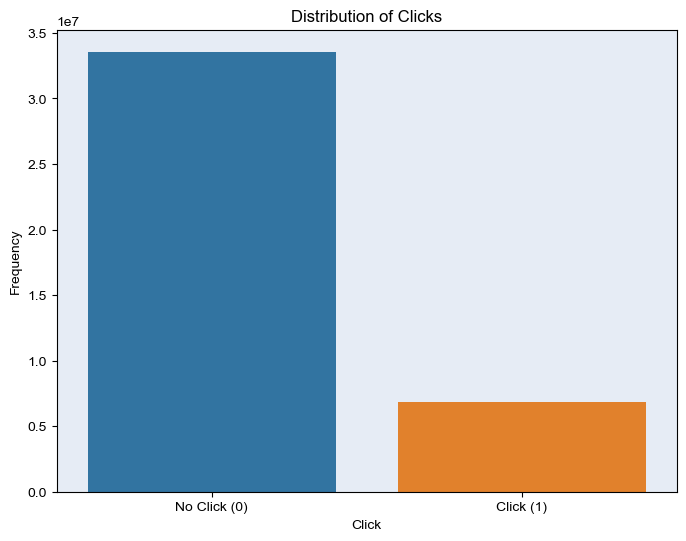

Click-Through Rate (CTR): 16.98%


In [6]:
# Analyzing the distribution of the target variable 'click'
click_distribution = df['click'].value_counts()

# Plotting the distribution

plt.figure(figsize=(8, 6))
sns.barplot(x=click_distribution.index, y=click_distribution.values)
sns.set_style("whitegrid", {'grid.linestyle': '-', 'axes.edgecolor': '1', 'grid.color': 'white'})
r, g, b = 230/255, 236/255, 245/255
plt.gca().set_facecolor((r, g, b))
plt.title('Distribution of Clicks')
plt.xlabel('Click')
plt.ylabel('Frequency')
plt.xticks([0, 1], ['No Click (0)', 'Click (1)'])
plt.show()

CTR = (click_distribution[1] / len(df)) * 100
print("Click-Through Rate (CTR): {:0.2f}%".format(CTR))

In [4]:
week_days = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]

df['hour of day'] = df['hour'].apply(lambda x: str(x.time())[:5])
df['day of week'] = df['hour'].apply(lambda x: week_days[x.weekday()])

# Calculating the sum of clicks and total number of ads for each 'hour'
click_hour = df.groupby('hour').agg({'click': 'sum', 'id': 'count'}).reset_index()
click_hour.columns = ['hour', 'total clicks', 'total ads']
click_hour['CTR'] = (click_hour['total clicks']/click_hour['total ads']) * 100

click_hr_day = df.groupby('hour of day').agg({'click': 'sum', 'id': 'count'}).reset_index()
click_hr_day.columns = ['hour of day', 'total clicks', 'total ads']
click_hr_day['CTR'] = (click_hr_day['total clicks']/click_hr_day['total ads']) * 100

click_day_wk = df.groupby('day of week').agg({'click': 'sum', 'id': 'count'}).reset_index()
click_day_wk.columns = ['day of week', 'total clicks', 'total ads']
click_day_wk['day of week'] = pd.Categorical(click_day_wk['day of week'], categories=week_days, ordered=True)
click_day_wk = click_day_wk.sort_values('day of week')
click_day_wk['CTR'] = (click_day_wk['total clicks']/click_day_wk['total ads']) * 100

ads = df.groupby(['hour of day', 'click']).size().unstack().reset_index()

In [14]:
fig = go.Figure(data=[
    go.Scatter(
        name='clicks/day',
        x=click_hour['hour'],
        y=click_hour['total clicks'],
        hovertemplate='Date: %{x|%d %B %Y} <br>Time: %{x|%H:%M:%S} <br>Day: %{x|%A} <br>Clicks: %{y}'
    ),
    go.Scatter(
        name='ads/day',
        x=click_hour['hour'],
        y=click_hour['total ads'],
        hovertemplate='Date: %{x|%d %B %Y} <br>Time: %{x|%H:%M:%S} <br>Day: %{x|%A} <br>Ads: %{y}',
        marker_color='rgb(26, 80, 100)'
    )
])

fig.update_layout(
    title='Trend of Ads and Clicks Grouped by Day for All Hours',
    xaxis_tickformat='%d %B <br>%Y', 
    xaxis_title='Hourly Data for 10 Days',
    yaxis_title='Number of Clicks / Ads'
)

fig.show()


In [11]:
fig = go.Figure(data=[
    go.Scatter(
        name='clicks/hr',
        x=click_hr_day['hour of day'],
        y=click_hr_day['total clicks'],
        hovertemplate='Time: %{x} <br>Clicks: %{y}'
    ),
    go.Scatter(
        name='ads/hr',
        x=click_hr_day['hour of day'],
        y=click_hr_day['total ads'],
        hovertemplate='Time: %{x} <br>Ads: %{y}',
        marker_color='rgb(26, 80, 100)'
    )
])

fig.update_layout(
    title='Trend of Ads and Clicks Grouped by Hours for All the Days',
    xaxis_title='Hours',
    yaxis_title='Number of Clicks / Ads'
)

fig.show()


In [12]:
fig = go.Figure(data=[
    go.Bar(name='Clicked', x=ads["hour of day"], y=ads[1], 
           hovertemplate='Time: %{x} <br>Clicks: %{y}', marker_color='rgb(55, 83, 109)'),
    go.Bar(name='Not Clicked', x=ads["hour of day"], y=ads[0], 
           hovertemplate='Time: %{x} <br>Clicks: %{y}', marker_color='rgb(26, 118, 255)')
])
# Change the bar mode
fig.update_layout(
    title = 'Hourly Ads based on Clicks',
    xaxis_title = 'Hour of the day',
    yaxis_title = 'Ads / hr',
    barmode='group',
    xaxis_type = None
    )
fig.show()

In [13]:
fig = px.bar(click_hr_day, x='hour of day', y='CTR',
             labels={'hour of day': 'Time'},
             height=400)

fig.update_layout(
    title = 'Hourly CTR',
    xaxis_title = 'Hour of the day',
    yaxis_title = 'Click-Through Rate (CTR)'',
    )
fig.show()

In [14]:
fig = px.bar(click_day_wk, x='day of week', y='CTR',
             labels={'day of week': 'Day'}, 
             height=400,)

fig.update_layout(
    title = 'Daily CTR',
    xaxis_title = 'Day of week',
    yaxis_title = 'Click-Through Rate (CTR)'',
    )
fig.show()

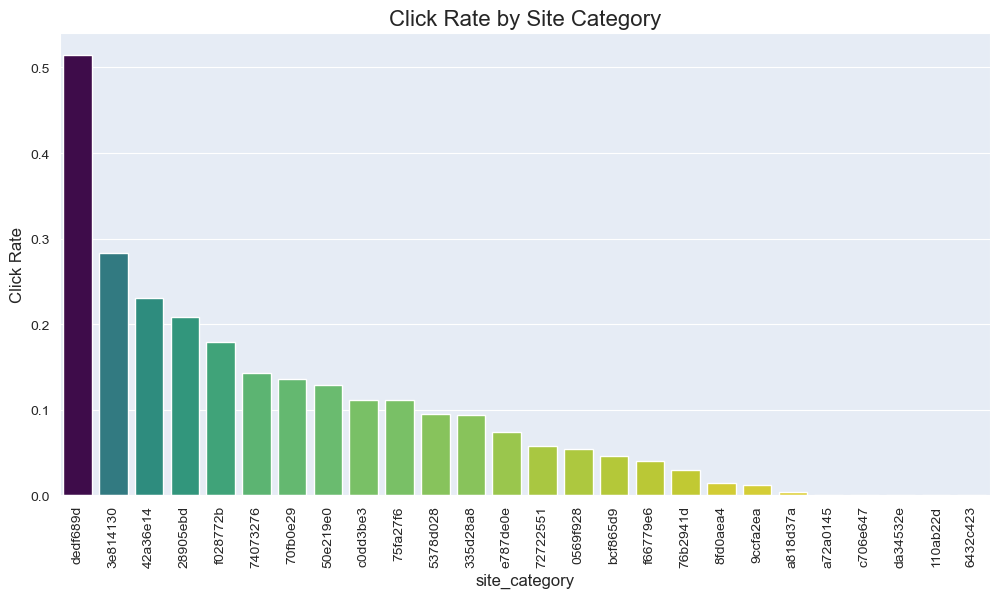

In [8]:
def plot_click_rate_by_category(feature, title, df, same_color=False):
    # Grouping by the feature and calculating click rate
    click_rate = df.groupby(feature)['click'].mean().sort_values(ascending=False)
    # Set the style with white gridlines
    sns.set_style('whitegrid', {'grid.linestyle': '-', 'axes.edgecolor': '1', 'grid.color': 'white'})

    plt.figure(figsize=(12, 6))
    
    if same_color:
        barplot = sns.barplot(x=click_rate.index, y=click_rate.values, color='cornflowerblue')
    else:
        # Create a reversed color palette that varies based on the bar height
        norm = plt.Normalize(click_rate.values.min(), click_rate.values.max())
        colors = plt.cm.viridis_r(norm(click_rate.values))  # Notice the "_r" suffix for reversed colormap
        barplot = sns.barplot(x=click_rate.index, y=click_rate.values, palette=colors)

    plt.title(title, fontsize=16)
    plt.ylabel('Click Rate', fontsize=12)
    plt.xlabel(feature, fontsize=12)
    plt.xticks(rotation=90, fontsize=10)
    plt.yticks(fontsize=10)

    # Convert RGB to Hex and set as background color
    r, g, b = 230/255, 236/255, 245/255
    plt.gca().set_facecolor((r, g, b))

    plt.show()


plot_click_rate_by_category('site_category', 'Click Rate by Site Category', df)

In [16]:
# Click Rate by App Category
plot_click_rate_by_category('app_category', 'Click Rate by App Category', df)

In [17]:
# Click Rate by Device Type
plot_click_rate_by_category('device_type', 'Click Rate by Device Type', df, same_color=True)

In [18]:
# Click Rate by Banner Position
plot_click_rate_by_category('banner_pos', 'Click Rate by Banner Position', df, same_color=True)

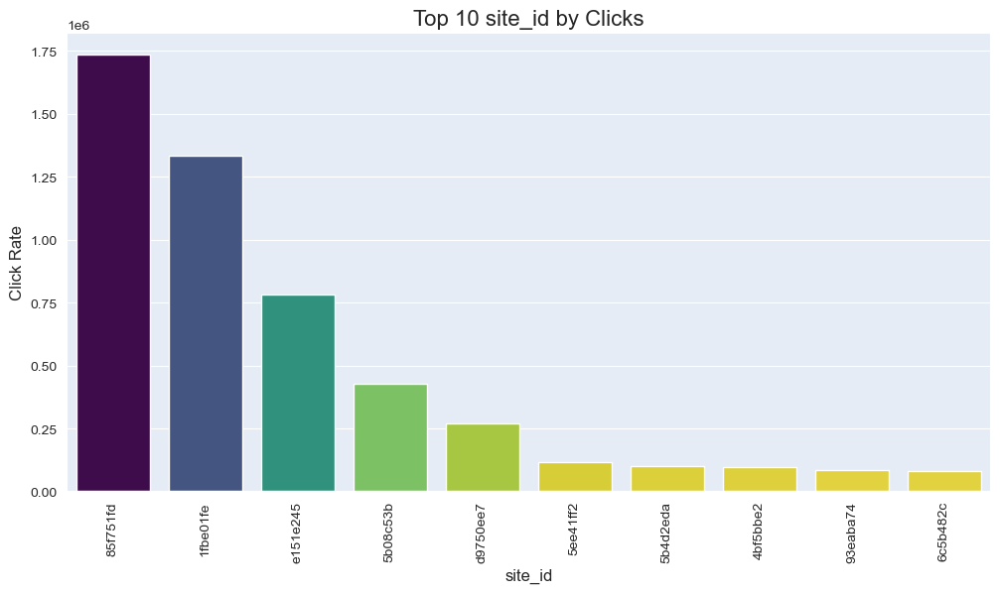

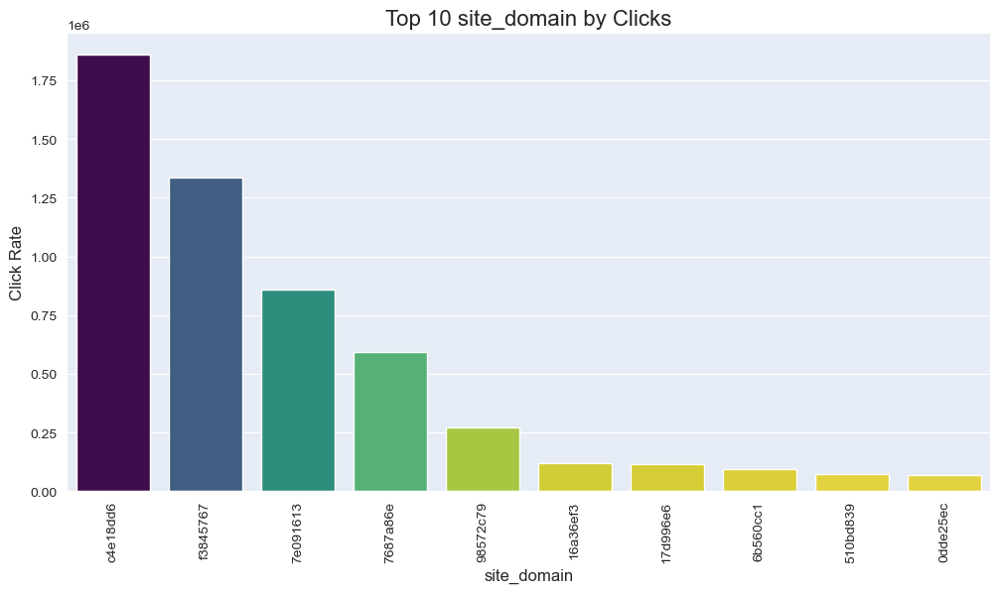

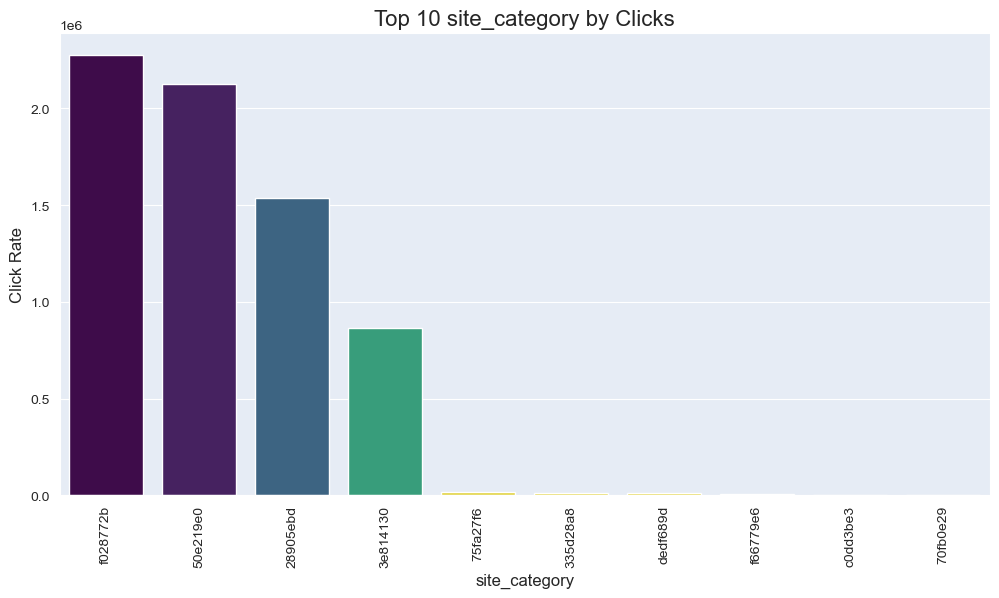

In [9]:
def plot_top_categories_by_clicks(feature,  df, top_n=10, same_color=False):
    # Grouping by the feature and calculating click rate
    feature_clicks = df.groupby(feature)['click'].sum().sort_values(ascending=False).head(top_n)
    # Set the style with white gridlines
    sns.set_style('whitegrid', {'grid.linestyle': '-', 'axes.edgecolor': '1', 'grid.color': 'white'})

    # Create a more visually appealing plot
    plt.figure(figsize=(12, 6))
    
    if same_color:
        barplot = sns.barplot(x=feature_clicks.index, y=feature_clicks.values, color='cornflowerblue')
    else:
        # Create a reversed color palette that varies based on the bar height
        norm = plt.Normalize(feature_clicks.values.min(), feature_clicks.values.max())
        colors = plt.cm.viridis_r(norm(feature_clicks.values))
        barplot = sns.barplot(x=feature_clicks.index, y=feature_clicks.values, palette=colors)

    plt.title(f'Top {top_n} {feature} by Clicks', fontsize=16)
    plt.ylabel('Click Rate', fontsize=12)
    plt.xlabel(feature, fontsize=12)
    plt.xticks(rotation=90, fontsize=10)
    plt.yticks(fontsize=10)

    # Convert RGB to Hex and set as background color
    r, g, b = 230/255, 236/255, 245/255
    plt.gca().set_facecolor((r, g, b))

    plt.show()


# Effect of Site Features on Clicks
#  Top 10 Site IDs by Clicks
plot_top_categories_by_clicks('site_id', df)

# Top 10 Site Domains by Clicks
plot_top_categories_by_clicks('site_domain', df)

# Top 10 Site Categories by Clicks
plot_top_categories_by_clicks('site_category', df)

In [20]:
# Effect of Device Features on Clicks
# Top 5 Device Types by Clicks
plot_top_categories_by_clicks('device_type', df, top_n=5, same_color=True)

# Top 10 Device Models by Clicks
plot_top_categories_by_clicks('device_model', df)

# Top 10 Device IDs by Clicks
plot_top_categories_by_clicks('device_id', df)

In [21]:
# Effect of App Features on Clicks
# Top 5 App IDs by Clicks
plot_top_categories_by_clicks('app_id', df)

# Top 5 App Domains by Clicks
plot_top_categories_by_clicks('app_domain', df)

# Top 5 App Categories by Clicks
plot_top_categories_by_clicks('app_category', df)

In [ ]:
# Checking for NaN values in the dataset
nan_values = df.isnull().sum()

# Identifying unique values for each column
unique_values_all = df.nunique().sort_values(ascending=False)

nan_values, unique_values_all

In [5]:
df['hour of day'] = df['hour of day'].apply(lambda x: int(x.split(':')[0]))
df = df.drop(['id', 'hour'], axis=1)

In [6]:
def convert_obj_to_int(fm):
    
    object_list_columns = fm.columns
    object_list_dtypes = fm.dtypes
    for index in range(0,len(object_list_columns)):
        if object_list_dtypes[index] == object :
            fm[object_list_columns[index]] = fm[object_list_columns[index]].apply(lambda x: hash(x))
    return fm

df_hashed = convert_obj_to_int(df)

df_hashed.head()

,click,C1,banner_pos,site_id,site_domain,site_category,app_id,app_domain,app_category,device_id,...,C14,C15,C16,C17,C18,C19,C20,C21,hour of day,day of week
0,0,1005,0,-8541903520513789143,-6020025617816918419,5643889831816603020,4225463563981189274,1424165039704570232,-307649581664399764,-4094531247861317391,...,15706,320,50,1722,0,35,-1,79,0,2949163978398626626
1,0,1005,0,-8541903520513789143,-6020025617816918419,5643889831816603020,4225463563981189274,1424165039704570232,-307649581664399764,-4094531247861317391,...,15704,320,50,1722,0,35,100084,79,0,2949163978398626626
2,0,1005,0,-8541903520513789143,-6020025617816918419,5643889831816603020,4225463563981189274,1424165039704570232,-307649581664399764,-4094531247861317391,...,15704,320,50,1722,0,35,100084,79,0,2949163978398626626
3,0,1005,0,-8541903520513789143,-6020025617816918419,5643889831816603020,4225463563981189274,1424165039704570232,-307649581664399764,-4094531247861317391,...,15706,320,50,1722,0,35,100084,79,0,2949163978398626626
4,0,1005,1,435842819404848584,7999787721191286397,8755923912711564083,4225463563981189274,1424165039704570232,-307649581664399764,-4094531247861317391,...,18993,320,50,2161,0,35,-1,157,0,2949163978398626626


In [7]:
cols = list(df_hashed.columns)
cols.remove('click')
scaler = StandardScaler()
df_hashed[cols] = scaler.fit_transform(df_hashed[cols])

df_hashed.head()

,click,C1,banner_pos,site_id,site_domain,site_category,app_id,app_domain,app_category,device_id,...,C14,C15,C16,C17,C18,C19,C20,C21,hour of day,day of week
0,0,0.029387,-0.568769,-1.387093,-1.024343,1.238178,0.408585,-0.027544,-0.103777,-0.264638,...,-0.632288,0.052504,-0.213594,-0.640947,-1.080131,-0.547385,-1.065277,-0.062346,-1.894189,-0.460139
1,0,0.029387,-0.568769,-1.387093,-1.024343,1.238178,0.408585,-0.027544,-0.103777,-0.264638,...,-0.632691,0.052504,-0.213594,-0.640947,-1.080131,-0.547385,0.938153,-0.062346,-1.894189,-0.460139
2,0,0.029387,-0.568769,-1.387093,-1.024343,1.238178,0.408585,-0.027544,-0.103777,-0.264638,...,-0.632691,0.052504,-0.213594,-0.640947,-1.080131,-0.547385,0.938153,-0.062346,-1.894189,-0.460139
3,0,0.029387,-0.568769,-1.387093,-1.024343,1.238178,0.408585,-0.027544,-0.103777,-0.264638,...,-0.632288,0.052504,-0.213594,-0.640947,-1.080131,-0.547385,0.938153,-0.062346,-1.894189,-0.460139
4,0,0.029387,1.406024,0.470712,2.531319,1.827418,0.408585,-0.027544,-0.103777,-0.264638,...,0.030486,0.052504,-0.213594,0.079419,-1.080131,-0.547385,-1.065277,1.047343,-1.894189,-0.460139


In [13]:
corr = df_hashed.corr()
fig = go.Figure(data=go.Heatmap(z=corr.values, x=corr.columns, y=corr.columns, colorscale="Viridis"))
fig.update_layout(height=800, width=800)
fig.show()

In [ ]:
def calc_vif(X):

    # Calculating VIF
    vif = pd.DataFrame()
    vif['variables'] = X.columns
    vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

    return vif

X = df_hashed.iloc[:,1:]
calc_vif(X)

In [8]:
df_hashed = df_hashed.drop(['C17', 'device_type'], axis=1)

In [9]:
X = df_hashed.iloc[:,1:]
y = df_hashed['click']
KBest = SelectKBest(score_func=f_classif, k=15)
KBest = KBest.fit(X,y)
df_scores = pd.DataFrame({'features': X.columns, 'f_classif': KBest.scores_, 'pValue': KBest.pvalues_ })
kb = KBest.get_support(indices=True)

df_scores, kb

(            features      f_classif         pValue
 0                 C1   54988.448573   0.000000e+00
 1         banner_pos   27116.928441   0.000000e+00
 2            site_id    3920.034033   0.000000e+00
 3        site_domain  119875.598475   0.000000e+00
 4      site_category  456660.980839   0.000000e+00
 5             app_id  233374.629801   0.000000e+00
 6         app_domain   44736.767551   0.000000e+00
 7       app_category    6817.989410   0.000000e+00
 8          device_id    7850.866479   0.000000e+00
 9          device_ip      38.931689   4.389022e-10
 10      device_model      42.618360   6.653274e-11
 11  device_conn_type  283227.128226   0.000000e+00
 12               C14  146896.426185   0.000000e+00
 13               C15   42804.467315   0.000000e+00
 14               C16  695073.900638   0.000000e+00
 15               C18   18930.476066   0.000000e+00
 16               C19     639.837907  3.633254e-141
 17               C20  134139.216192   0.000000e+00
 18         

In [10]:
df_scores = pd.DataFrame({'features': X.columns, 'f_classif': KBest.scores_, 'pValue': KBest.pvalues_ })
df_scores

,features,f_classif,pValue
0,C1,54988.448573,0.000000e+00
1,banner_pos,27116.928441,0.000000e+00
2,site_id,3920.034033,0.000000e+00
3,site_domain,119875.598475,0.000000e+00
4,site_category,456660.980839,0.000000e+00
5,app_id,233374.629801,0.000000e+00
6,app_domain,44736.767551,0.000000e+00
7,app_category,6817.989410,0.000000e+00
8,device_id,7850.866479,0.000000e+00
9,device_ip,38.931689,4.389022e-10


In [11]:
kb = KBest.get_support(indices=True)
kb

array([ 0,  1,  3,  4,  5,  6,  8, 11, 12, 13, 14, 15, 17, 18, 20])

In [12]:
df_reduced = df_hashed[df_hashed.columns[kb]]
df_reduced.head()

,click,C1,site_id,site_domain,site_category,app_id,app_category,device_model,device_conn_type,C14,C15,C16,C19,C20,hour of day
0,0,0.029387,-1.387093,-1.024343,1.238178,0.408585,-0.103777,-1.342665,1.952150,-0.632288,0.052504,-0.213594,-0.547385,-1.065277,-1.894189
1,0,0.029387,-1.387093,-1.024343,1.238178,0.408585,-0.103777,-0.177441,-0.387597,-0.632691,0.052504,-0.213594,-0.547385,0.938153,-1.894189
2,0,0.029387,-1.387093,-1.024343,1.238178,0.408585,-0.103777,0.234134,-0.387597,-0.632691,0.052504,-0.213594,-0.547385,0.938153,-1.894189
3,0,0.029387,-1.387093,-1.024343,1.238178,0.408585,-0.103777,-0.212941,-0.387597,-0.632288,0.052504,-0.213594,-0.547385,0.938153,-1.894189
4,0,0.029387,0.470712,2.531319,1.827418,0.408585,-0.103777,-1.456150,-0.387597,0.030486,0.052504,-0.213594,-0.547385,-1.065277,-1.894189


In [13]:
X = df_reduced.iloc[:,1:]
y = df_reduced['click']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)

In [286]:
sample_size = int(len(df_reduced) * 0.1)
df_sampled = df_reduced.sample(n=sample_size, random_state=1)

# Separate features and target variable
X = df_sampled.iloc[:, 1:]
y = df_sampled['click']

# Shuffle and split the dataset
X, y = shuffle(X, y, random_state=1)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)

In [ ]:
start_time = time.time()

model = DecisionTreeClassifier()
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
scores = cross_val_score(model, X_train, y_train, scoring='roc_auc', cv=cv, n_jobs=-1)
print("Mean ROC AUC: {:.3f}".format(np.mean(scores)))

end_time = time.time()

duration = end_time - start_time
print("Time taken: {:.3f} seconds".format(duration))

In [ ]:
model = DecisionTreeClassifier()
over = SMOTE(random_state=2, sampling_strategy=0.4, k_neighbors=1)
under = RandomUnderSampler(sampling_strategy=0.5)
steps = [('o', over), ('u', under)]
pipeline = Pipeline(steps=steps)
Xn, yn = pipeline.fit_resample(X_train, y_train.ravel())
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
scores = cross_val_score(model, Xn, yn, scoring='roc_auc', cv=cv, n_jobs=-1)
score = np.mean(scores)
print("k={}, Mean ROC AUC: {:.3f}".format(3, score))

In [ ]:
np.save("train.npy", Xn)
np.save("train_labels.npy", yn)

In [ ]:
X_train = np.load("train.npy")
y_train = np.load("train_labels.npy")

In [252]:
def optimize_hyperparameters(X_train_data, X_test_data, y_train_data, 
                       model, param_grid, n_jobs, cv=10, scoring_fit='neg_mean_squared_error'):
    gs = GridSearchCV(
        estimator=model,
        param_grid=param_grid, 
        cv=cv, 
        n_jobs=n_jobs, 
        scoring=scoring_fit,
        verbose=2
    )
    
    model = gs.fit(X_train_data, y_train_data)
    preds = model.predict(X_test_data)
    
    return model, preds

In [253]:
model = LogisticRegressionCV(cv=5)
model.fit(X_train, y_train)
yhat = model.predict(X_test)
probs = model.predict_proba(X_test)
accuracy = accuracy_score(y_test, yhat)
print("Model accuracy: {}".format(accuracy))

Model accuracy: 0.8285982834104232


In [254]:
start_time = time.time()

param_grid = {
    'C':np.logspace(0, 4, 10),
    'penalty': ['l1', 'l2']
}
model = LogisticRegression()
model, y_pred = optimize_hyperparameters(X_train, X_test, y_train, model, 
                                 param_grid, n_jobs=-1, cv=5, scoring_fit='roc_auc')

probs = model.predict_proba(X_test)

end_time = time.time()
duration = end_time - start_time
print("Time taken: {:.3f} seconds".format(duration))

print(model.best_score_)
print(model.best_params_)

Fitting 5 folds for each of 20 candidates, totalling 100 fits
Time taken: 31.074 seconds
0.6264909208298395
{'C': 166.81005372000593, 'penalty': 'l2'}


In [255]:
accuracy = accuracy_score(y_test, yhat)
print("Model accuracy: {}".format(accuracy))

Model accuracy: 0.8285735486902965


In [256]:
def prediction_interval(accuracy, z, num_samples):
  accuracy_interval = z * np.sqrt((accuracy * (1 - accuracy)) / num_samples)
  accuracy_lower = accuracy - accuracy_interval
  accuracy_upper = accuracy + accuracy_interval
  return accuracy_interval, accuracy_lower, accuracy_upper

In [257]:
interval, lower, upper = prediction_interval(accuracy, 1.96, X_test.shape[0])
print("interval: {:.4f}, lower: {:.4f}, upper: {:.4f}".format(interval, lower, upper))

interval: 0.0012, lower: 0.8274, upper: 0.8297


In [259]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.83      1.00      0.91    335333
           1       0.15      0.00      0.00     68957

    accuracy                           0.83    404290
   macro avg       0.49      0.50      0.45    404290
weighted avg       0.71      0.83      0.75    404290



In [262]:
fpr, tpr, thresholds = roc_curve(y_test, probs[:,1])

In [263]:
def plot_auc_roc(fpr, tpr):
  fig = px.area(
      x=fpr, y=tpr,
      title=f'ROC Curve (AUC={auc(fpr, tpr):.4f})',
      labels=dict(x='False Positive Rate', y='True Positive Rate'),
      width=700, height=500
  )
  fig.add_shape(
      type='line', line=dict(dash='dash'),
      x0=0, x1=1, y0=0, y1=1
  )

  fig.update_yaxes(scaleanchor="x", scaleratio=1)
  fig.update_xaxes(constrain='domain')
  fig.show()

In [264]:
plot_auc_roc(fpr, tpr)

In [139]:
#Baseline model
model = XGBClassifier()
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("Model accuracy: {}".format(accuracy))

Model accuracy: 0.8339063543496006


In [140]:
start_time = time.time()

param_grid = {
    'max_depth': range (4, 10, 1),
    'n_estimators': [60],
    'reg_alpha':[1e-2, 0.1, 1],
    'gamma':[i/10.0 for i in range(0, 8, 2)]
}
model = XGBClassifier(max_depth=9, n_estimators=40, reg_alpha=0.1, gamma=0.3)
model, preds = optimize_hyperparameters(X_train, X_test, y_train, model, 
                                 param_grid, n_jobs=-1, cv=5, scoring_fit='roc_auc')

probs = model.predict_proba(X_test)
print(model.best_score_)
print(model.best_params_)

end_time = time.time()

duration = end_time - start_time
print("Time taken: {:.3f} seconds".format(duration))

Fitting 5 folds for each of 72 candidates, totalling 360 fits
0.7334793686303187
{'gamma': 0.0, 'max_depth': 9, 'n_estimators': 60, 'reg_alpha': 1}
Time taken: 1635.741 seconds


In [265]:
model = XGBClassifier(max_depth=9, n_estimators=100, reg_alpha=1, gamma=0.0)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
probs = model.predict_proba(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("Model accuracy: {}".format(accuracy))

Model accuracy: 0.8337752603329294


In [266]:
interval, lower, upper = prediction_interval(accuracy, 1.96, X_test.shape[0])
print("interval: {:.4f}, lower: {:.4f}, upper: {:.4f}".format(interval, lower, upper))

interval: 0.0011, lower: 0.8326, upper: 0.8349


In [267]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.84      0.99      0.91    335333
           1       0.60      0.08      0.14     68957

    accuracy                           0.83    404290
   macro avg       0.72      0.53      0.52    404290
weighted avg       0.80      0.83      0.78    404290



In [268]:
fpr, tpr, thresholds = roc_curve(y_test, probs[:,1])

In [269]:
plot_auc_roc(fpr, tpr)

In [270]:
model = LGBMClassifier()
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("Model accuracy: {}".format(accuracy))

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 274794, number of negative: 1342364
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.039863 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1492
[LightGBM] [Info] Number of data points in the train set: 1617158, number of used features: 14
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.169924 -> initscore=-1.586166
[LightGBM] [Info] Start training from score -1.586166
Model accuracy: 0.8326918795913825


In [168]:
start_time = time.time()

param_grid = {
    'learning_rate': [0.01, 0.1, 0.5],
    'max_depth': range(5, 9, 1),
    'num_leaves':[30, 40],
    'n_estimators': [100],
    'reg_alpha': [0.1, 1, 5]
}

model = LGBMClassifier(verbose=0)
grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=5, scoring='roc_auc', n_jobs=-1)
grid_search.fit(X_train, y_train)

print("Best ROC AUC Score: {:.4f}".format(grid_search.best_score_))
print("Best Parameters:", grid_search.best_params_)

probs = grid_search.predict_proba(X_test)

end_time = time.time()
duration = end_time - start_time
print("Time taken: {:.3f} seconds".format(duration))

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
Best ROC AUC Score: 0.7328
Best Parameters: {'learning_rate': 0.2, 'max_depth': 8, 'n_estimators': 100, 'num_leaves': 40, 'reg_alpha': 2}
Time taken: 278.617 seconds


In [281]:
model = LGBMClassifier(max_depth=8, n_estimators=1000, reg_alpha=1, num_leaves=40, learning_rate=0.1, verbose=0)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
probs = model.predict_proba(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("Model accuracy: {}".format(accuracy))

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
Model accuracy: 0.8339904523980312


In [282]:
interval, lower, upper = prediction_interval(accuracy, 1.96, X_test.shape[0])
print("interval: {:.4f}, lower: {:.4f}, upper: {:.4f}".format(interval, lower, upper))

interval: 0.0011, lower: 0.8328, upper: 0.8351


In [283]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.84      0.99      0.91    335333
           1       0.61      0.08      0.14     68957

    accuracy                           0.83    404290
   macro avg       0.72      0.53      0.52    404290
weighted avg       0.80      0.83      0.78    404290



In [284]:
fpr, tpr, thresholds = roc_curve(y_test, probs[:,1])

In [285]:
plot_auc_roc(fpr, tpr)

In [71]:
model = Sequential()
model.add(Dense(10, input_dim=14, activation='relu'))
model.add(Dense(7, activation='relu'))
model.add(Dense(1, activation='sigmoid'))

optimizer = SGD(learning_rate=0.15, momentum=0.9)
model.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy', 'AUC'])

early_stopping = EarlyStopping(monitor='val_auc', patience=5, verbose=1, mode='max')

history = model.fit(X_train, y_train, epochs=20, batch_size=32, callbacks=[early_stopping], validation_split=0.2)

Epoch 1/20
8086/8086 [==============================] - 12s 1ms/step - loss: 0.4401 - accuracy: 0.8289 - auc: 0.6243 - val_loss: 0.4329 - val_accuracy: 0.8301 - val_auc: 0.6496
Epoch 2/20
8086/8086 [==============================] - 10s 1ms/step - loss: 0.4370 - accuracy: 0.8294 - auc: 0.6349 - val_loss: 0.4350 - val_accuracy: 0.8306 - val_auc: 0.6445
Epoch 3/20
8086/8086 [==============================] - 12s 1ms/step - loss: 0.4361 - accuracy: 0.8295 - auc: 0.6402 - val_loss: 0.4332 - val_accuracy: 0.8308 - val_auc: 0.6513
Epoch 4/20
8086/8086 [==============================] - 12s 1ms/step - loss: 0.4359 - accuracy: 0.8299 - auc: 0.6410 - val_loss: 0.4330 - val_accuracy: 0.8304 - val_auc: 0.6498
Epoch 5/20
8086/8086 [==============================] - 12s 1ms/step - loss: 0.4368 - accuracy: 0.8293 - auc: 0.6377 - val_loss: 0.4349 - val_accuracy: 0.8296 - val_auc: 0.6496
Epoch 6/20
8086/8086 [==============================] - 13s 2ms/step - loss: 0.4352 - accuracy: 0.8297 - auc: 0.644

In [77]:
model = Sequential()
model.add(Dense(10, input_dim=14, activation='tanh'))
model.add(Dense(7, activation='tanh'))
model.add(Dense(1, activation='sigmoid'))

optimizer = SGD(learning_rate=0.15, momentum=0.9)
model.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy', 'AUC'])

early_stopping = EarlyStopping(monitor='val_auc', patience=5, verbose=1, mode='max')

history = model.fit(X_train, y_train, epochs=20, batch_size=32, callbacks=[early_stopping], validation_split=0.2)

Epoch 1/20
8086/8086 [==============================] - 11s 1ms/step - loss: 0.4398 - accuracy: 0.8289 - auc: 0.6353 - val_loss: 0.4314 - val_accuracy: 0.8296 - val_auc: 0.6653
Epoch 2/20
8086/8086 [==============================] - 12s 1ms/step - loss: 0.4347 - accuracy: 0.8291 - auc: 0.6552 - val_loss: 0.4306 - val_accuracy: 0.8275 - val_auc: 0.6760
Epoch 3/20
8086/8086 [==============================] - 11s 1ms/step - loss: 0.4329 - accuracy: 0.8290 - auc: 0.6610 - val_loss: 0.4273 - val_accuracy: 0.8303 - val_auc: 0.6807
Epoch 4/20
8086/8086 [==============================] - 10s 1ms/step - loss: 0.4330 - accuracy: 0.8290 - auc: 0.6617 - val_loss: 0.4275 - val_accuracy: 0.8264 - val_auc: 0.6788
Epoch 5/20
8086/8086 [==============================] - 10s 1ms/step - loss: 0.4320 - accuracy: 0.8289 - auc: 0.6648 - val_loss: 0.4369 - val_accuracy: 0.8296 - val_auc: 0.6843
Epoch 6/20
8086/8086 [==============================] - 10s 1ms/step - loss: 0.4311 - accuracy: 0.8290 - auc: 0.666

In [105]:
model = Sequential()
model.add(Dense(10, input_dim=14, activation='tanh'))
model.add(Dense(7, activation='tanh'))
model.add(Dense(1, activation='sigmoid'))

optimizer = Adam(learning_rate=0.001, beta_1=0.9)
model.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy', 'AUC'])

early_stopping = EarlyStopping(monitor='val_auc', patience=5, verbose=1, mode='max')

history = model.fit(X_train, y_train, epochs=20, batch_size=32, callbacks=[early_stopping], validation_split=0.2)

Epoch 1/20
8086/8086 [==============================] - 12s 1ms/step - loss: 0.4424 - accuracy: 0.8254 - auc: 0.6276 - val_loss: 0.4337 - val_accuracy: 0.8285 - val_auc: 0.6508
Epoch 2/20
8086/8086 [==============================] - 12s 1ms/step - loss: 0.4327 - accuracy: 0.8296 - auc: 0.6531 - val_loss: 0.4308 - val_accuracy: 0.8290 - val_auc: 0.6614
Epoch 3/20
8086/8086 [==============================] - 11s 1ms/step - loss: 0.4306 - accuracy: 0.8299 - auc: 0.6606 - val_loss: 0.4296 - val_accuracy: 0.8276 - val_auc: 0.6675
Epoch 4/20
8086/8086 [==============================] - 11s 1ms/step - loss: 0.4288 - accuracy: 0.8300 - auc: 0.6676 - val_loss: 0.4276 - val_accuracy: 0.8303 - val_auc: 0.6739
Epoch 5/20
8086/8086 [==============================] - 11s 1ms/step - loss: 0.4273 - accuracy: 0.8303 - auc: 0.6727 - val_loss: 0.4269 - val_accuracy: 0.8299 - val_auc: 0.6762
Epoch 6/20
8086/8086 [==============================] - 11s 1ms/step - loss: 0.4265 - accuracy: 0.8304 - auc: 0.675

In [245]:
class CosineLearningRateSchedule(keras.callbacks.Callback):
    def __init__(self, max_lr, warmup_epochs, total_epochs):
        super(CosineLearningRateSchedule, self).__init__()
        self.max_lr = max_lr
        self.warmup_epochs = warmup_epochs
        self.total_epochs = total_epochs
        self.initial_lr = max_lr / warmup_epochs

    def on_epoch_begin(self, epoch, logs=None):
        if epoch < self.warmup_epochs:
            lr = self.initial_lr * (epoch + 1)
        else:
            decayed_lr = 0.5 * self.max_lr * (1 + math.cos(math.pi * (epoch - self.warmup_epochs) / (self.total_epochs - self.warmup_epochs)))
            lr = max(decayed_lr, 1e-7)
        keras.backend.set_value(self.model.optimizer.lr, lr)

model = Sequential()
model.add(Dense(10, input_dim=14, activation='tanh'))
model.add(Dense(7, activation='tanh'))
model.add(Dense(1, activation='sigmoid'))

# Compile the model
model.compile(loss='binary_crossentropy', optimizer=Adam(learning_rate=0.001), metrics=['accuracy', 'AUC'])

# Cosine Learning Rate Schedule with Warm-up
cosine_lr_schedule = CosineLearningRateSchedule(max_lr=0.01, warmup_epochs=5, total_epochs=20)

# Fit the model
history = model.fit(X_train, y_train, epochs=20, batch_size=32, callbacks=[cosine_lr_schedule, early_stopping], validation_split=0.2)


Epoch 1/20
8086/8086 [==============================] - 12s 1ms/step - loss: 0.4381 - accuracy: 0.8279 - auc: 0.6383 - val_loss: 0.4315 - val_accuracy: 0.8298 - val_auc: 0.6621
Epoch 2/20
8086/8086 [==============================] - 11s 1ms/step - loss: 0.4305 - accuracy: 0.8289 - auc: 0.6640 - val_loss: 0.4280 - val_accuracy: 0.8304 - val_auc: 0.6742
Epoch 3/20
8086/8086 [==============================] - 10s 1ms/step - loss: 0.4283 - accuracy: 0.8295 - auc: 0.6712 - val_loss: 0.4285 - val_accuracy: 0.8300 - val_auc: 0.6711
Epoch 4/20
8086/8086 [==============================] - 11s 1ms/step - loss: 0.4270 - accuracy: 0.8295 - auc: 0.6761 - val_loss: 0.4238 - val_accuracy: 0.8304 - val_auc: 0.6855
Epoch 5/20
8086/8086 [==============================] - 12s 1ms/step - loss: 0.4266 - accuracy: 0.8299 - auc: 0.6774 - val_loss: 0.4248 - val_accuracy: 0.8297 - val_auc: 0.6841
Epoch 6/20
8086/8086 [==============================] - 11s 1ms/step - loss: 0.4255 - accuracy: 0.8302 - auc: 0.680

In [246]:
probs = model.predict(X_test)
preds = np.argmax(probs, axis=-1)
accuracy = accuracy_score(y_test, preds)
print("Model accuracy: {}".format(accuracy))

2527/2527 [==============================] - 3s 1ms/step
Model accuracy: 0.830109574810161


In [247]:
interval, lower, upper = prediction_interval(accuracy, 1.96, X_test.shape[0])
print("interval: {:.4f}, lower: {:.4f}, upper: {:.4f}".format(interval, lower, upper))

interval: 0.0026, lower: 0.8275, upper: 0.8327


In [248]:
print(classification_report(y_test, preds))

              precision    recall  f1-score   support

           0       0.83      1.00      0.91     67121
           1       0.00      0.00      0.00     13737

    accuracy                           0.83     80858
   macro avg       0.42      0.50      0.45     80858
weighted avg       0.69      0.83      0.75     80858



In [249]:
fpr, tpr, thresholds = roc_curve(y_test, probs)

In [250]:
plot_auc_roc(fpr, tpr)